<a href="https://colab.research.google.com/github/thalisrocha/Segmentation/blob/main/TP_30_09_THALIS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Functions


In [ ]:
import math
import numpy as np
import matplotlib.pyplot as plt
import skimage as sk

from scipy import ndimage
from scipy import signal

from skimage import io

from skimage import filters

import skimage.morphology as morpho
import skimage.feature as skf
from scipy import ndimage as ndi

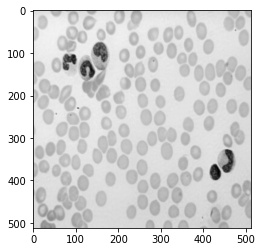

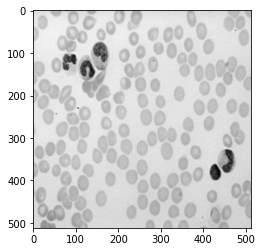

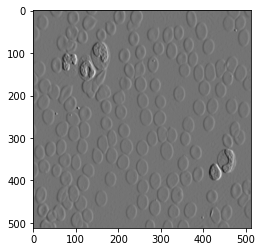

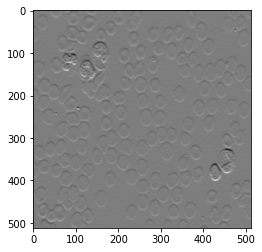

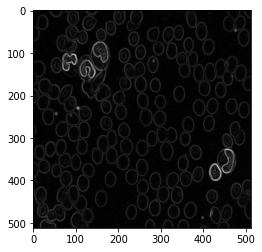

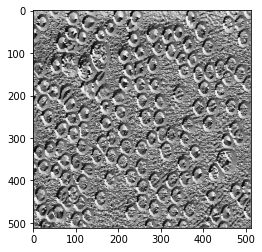

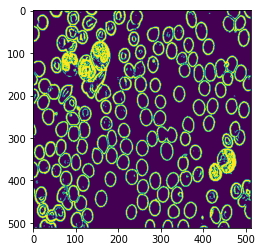

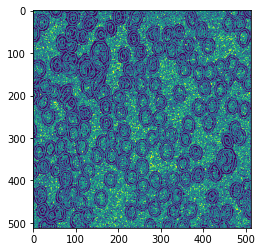

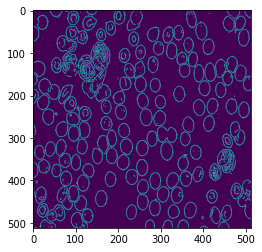

In [ ]:
import sobel
import mrlab as mr
from skimage import io as skio

In [ ]:
def median_filter(im,typ=1,r=1,xy=None):
    # """ renvoie le median de l'image im.
    # si typ==1 (defaut) le median est calcule sur un carre de cote 2r+1
    # si typ==2 : disque de rayon r
    # si typ==3 alors xy est un couple de liste de x et liste de y
    #      ([-1,0,1] , [0,0,0]) donne un median sur un segment horizontql de taille trois.
    #      """
    lx=[]
    ly=[]
    (ty,tx)=im.shape
    if typ==1: #carre

        for k in range(-r,r+1):
            for l in range(-r,r+1):
                lx.append(k)
                ly.append(l)

    elif typ==2:
        for k in range(-r,r+1):
            for l in range(-r,r+1):
                if k**2+l**2<=r**2:
                    lx.append(k)
                    ly.append(l)
    else: #freeshape
        lx,ly=xy

    debx=-min(lx) #min is supposed negatif
    deby=-min(ly)
    finx=tx-max(lx) #max is supposed positif
    finy=ty-max(ly)
    ttx=finx-debx
    tty=finy-deby
    tab=np.zeros((len(lx),ttx*tty))
    #print (lx,ly)
    #print(ttx,tty)
    #print(im[deby+ly[k]:tty+ly[k]+deby,debx+lx[k]:debx+ttx+lx[k]].reshape(-1).shape)
    for k in range(len(lx)):
        tab[k,:]=im[deby+ly[k]:deby+tty+ly[k],debx+lx[k]:debx+ttx+lx[k]].reshape(-1)
    out=im.copy()
    out[deby:finy,debx:finx]=np.median(tab,axis=0).reshape((tty,ttx))
    return out

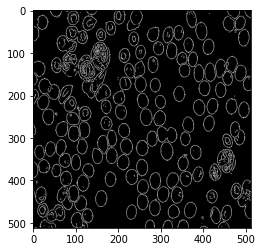

In [ ]:
ima=io.imread('cell.tif')
sigma=0
seuilnorme=0.1

gfima=filters.gaussian(ima,sigma)

gradx=mr.sobelGradX(gfima)
grady=mr.sobelGradY(gfima)

norme=np.sqrt(gradx*gradx+grady*grady)

direction=np.arctan2(grady,gradx)

contoursnorme =(norme>seuilnorme)

contours=np.uint8(mr.maximaDirectionGradient(gradx,grady))

valcontours=(norme>seuilnorme)*contours

plt.figure()
plt.imshow(255*valcontours, cmap='gray')
plt.show()



## 1.1

In [ ]:
ima=io.imread('cell.tif')
sigma=0
# seuilnorme=30
seuilnorme=0.1

gfima=filters.gaussian(ima,sigma)
#gfima=ima.copy()
gradx=mr.sobelGradX(gfima)

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
axs[0].imshow(ima, cmap="gray")
axs[1].imshow(gfima, cmap="gray")
axs[2].imshow(gradx, cmap="gray")
axs[0].set_title('Image originale',fontdict = {'fontsize' : 15})
axs[1].set_title('Image filtrée (passe-bas)',fontdict = {'fontsize' : 15})
axs[2].set_title('Gradient horizontal',fontdict = {'fontsize' : 15})

grady=mr.sobelGradY(gfima)
norme=np.sqrt(gradx*gradx+grady*grady)
direction=np.arctan2(grady,gradx)

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
axs[0].imshow(grady, cmap="gray")
axs[1].imshow(norme, cmap="gray")
axs[2].imshow(direction, cmap="gray")
axs[0].set_title('Gradient vertical',fontdict = {'fontsize' : 15})
axs[1].set_title('Norme du gradient',fontdict = {'fontsize' : 15})
axs[2].set_title('Direction du Gradient',fontdict = {'fontsize' : 15})

contoursnorme =(norme>seuilnorme)
contours=np.uint8(mr.maximaDirectionGradient(gradx,grady))
valcontours=(norme>seuilnorme)*contours

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
axs[0].imshow(255*contoursnorme, cmap="gray")
axs[1].imshow(255*contours, cmap="gray")
axs[2].imshow(255*valcontours, cmap="gray")
axs[0].set_title('Norme seuillé',fontdict = {'fontsize' : 15})
axs[1].set_title('Maxima du gradient dans \n la direction du gradient',fontdict = {'fontsize' : 15})
axs[2].set_title('',fontdict = {'fontsize' : 15})


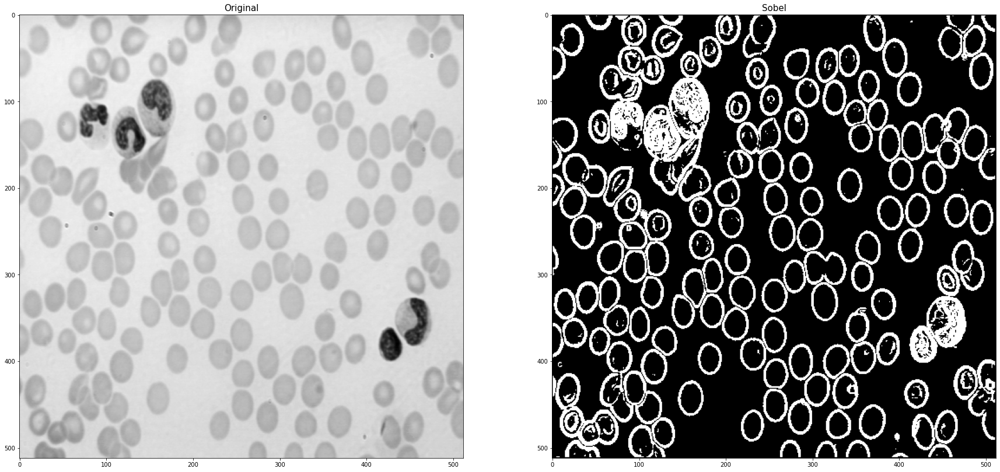

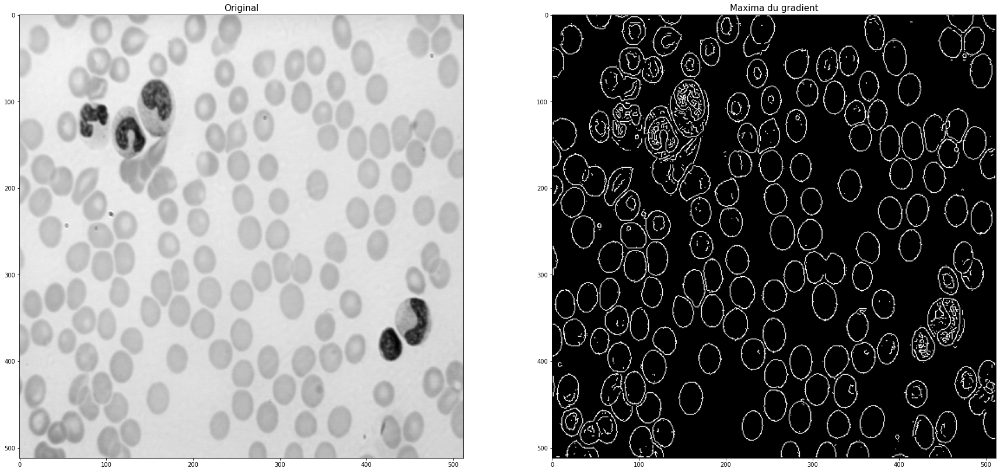

In [ ]:
ima=io.imread('cell.tif')
sigma=0
# seuilnorme=30
seuilnorme=0.1

gfima=filters.gaussian(ima,sigma)
#gfima=ima.copy()
gradx=mr.sobelGradX(gfima)

grady=mr.sobelGradY(gfima)
norme=np.sqrt(gradx*gradx+grady*grady)
direction=np.arctan2(grady,gradx)

contoursnorme =(norme>seuilnorme)
contours=np.uint8(mr.maximaDirectionGradient(gradx,grady))
valcontours=(norme>seuilnorme)*contours

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(30, 30))
axs[0].imshow(ima, cmap="gray")
axs[1].imshow(255*contoursnorme, cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' : 15})
axs[1].set_title('Sobel',fontdict = {'fontsize' : 15})

fig.savefig('sobel.png', bbox_inches='tight')

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(30, 30))
axs[0].imshow(ima, cmap="gray")
axs[1].imshow(255*valcontours, cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' : 15})
axs[1].set_title('Maxima du gradient',fontdict = {'fontsize' : 15})

fig.savefig('max.png', bbox_inches='tight')


Le filtre de Sobel ajoute un filtrage passe bas pas très fort à l'image, compte tenu du noyau de convolution utilisé. En plus, le filtre de Sobel prend en compte un nombre plus grand de pixels dans le voisinage, en donnant plus d'importance aux pixels les plus proches (à droite et à gauche), ce qui le rend plus robuste par rapport au filtre différence.

Par conséquent, l'intérêt du filtre de Sobel est de réduire le bruit et fournir des contours plus propres.

**Au-délà d'un élement dérivateur, le filtre Sobel a aussi un élement integrateur, étant donné son noyau de convolution. Cette caractéristique dispense l'application d'un filtre passe bas avant l'application du gradient de Sobel.**

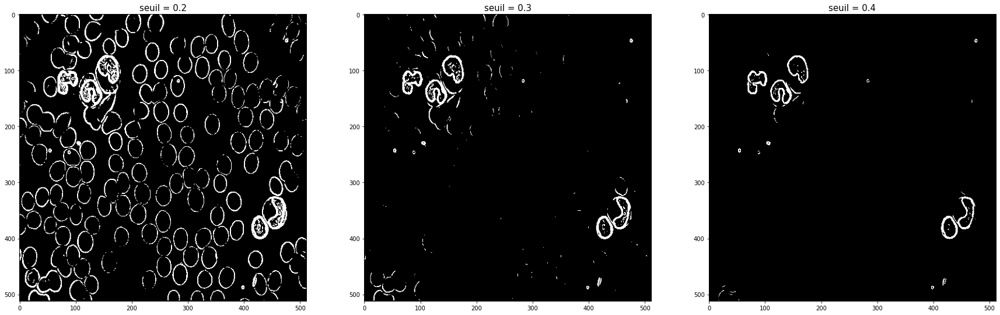

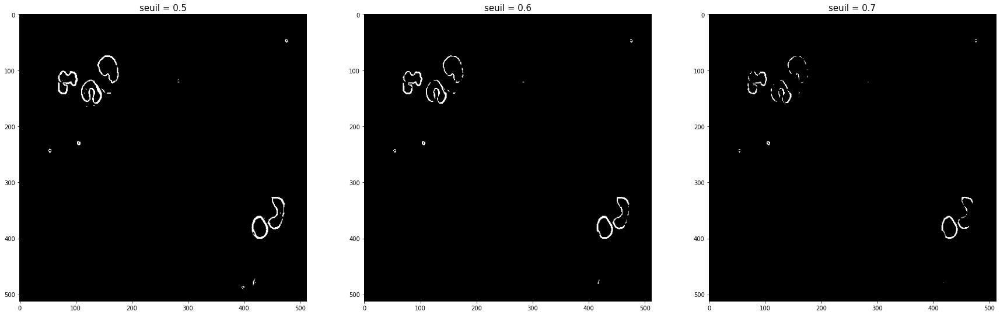

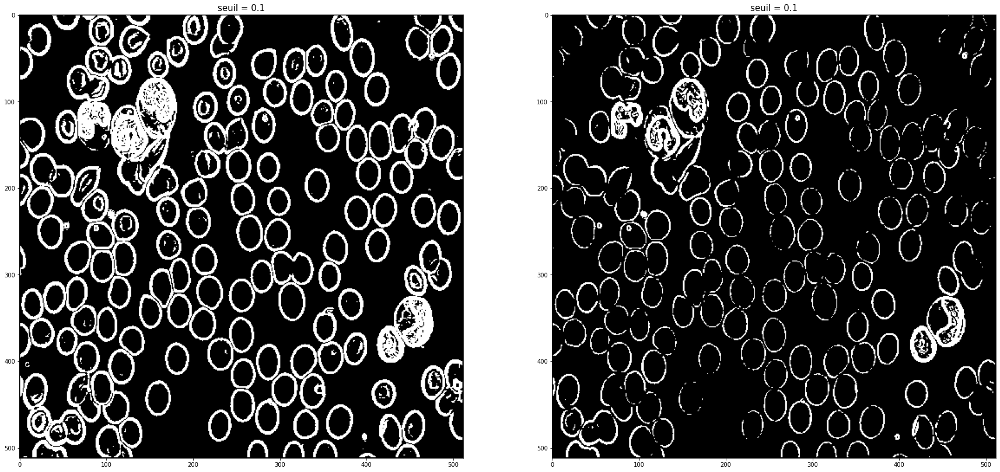

In [ ]:
seuilnorme = 0.2
contoursnorme1 =(norme>seuilnorme)

seuilnorme = 0.3
contoursnorme2 =(norme>seuilnorme)

seuilnorme = 0.4
contoursnorme3 =(norme>seuilnorme)

seuilnorme = 0.5
contoursnorme4 =(norme>seuilnorme)

seuilnorme = 0.6
contoursnorme5 =(norme>seuilnorme)

seuilnorme = 0.7
contoursnorme6 =(norme>seuilnorme)

seuilnorme = 0.1
contoursnorme7 =(norme>seuilnorme)

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
axs[0].imshow(255*contoursnorme1, cmap="gray")
axs[1].imshow(255*contoursnorme2, cmap="gray")
axs[2].imshow(255*contoursnorme3, cmap="gray")
axs[0].set_title('seuil = 0.2',fontdict = {'fontsize' : 15})
axs[1].set_title('seuil = 0.3',fontdict = {'fontsize' : 15})
axs[2].set_title('seuil = 0.4',fontdict = {'fontsize' : 15})

fig.savefig('1.png', bbox_inches="tight")

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(30, 30))
axs[0].imshow(255*contoursnorme4, cmap="gray")
axs[1].imshow(255*contoursnorme5, cmap="gray")
axs[2].imshow(255*contoursnorme6, cmap="gray")
axs[0].set_title('seuil = 0.5',fontdict = {'fontsize' : 15})
axs[1].set_title('seuil = 0.6',fontdict = {'fontsize' : 15})
axs[2].set_title('seuil = 0.7',fontdict = {'fontsize' : 15})

fig.savefig('1-2.png', bbox_inches="tight")

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(30, 30))
axs[0].imshow(255*contoursnorme7, cmap="gray")
axs[1].imshow(255*contoursnorme1, cmap="gray")
axs[0].set_title('seuil = 0.1',fontdict = {'fontsize' : 15})
axs[1].set_title('seuil = 0.1',fontdict = {'fontsize' : 15})


fig.savefig('1-3.png', bbox_inches="tight")


**changez le seuil**



## 1.2




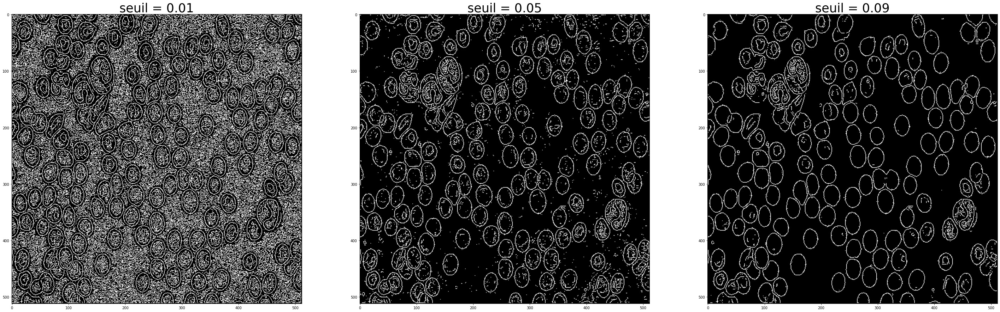

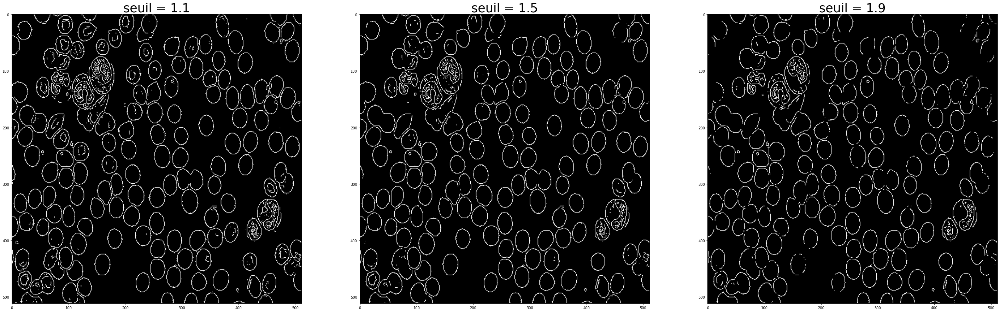

In [ ]:
im_max = mr.maximaDirectionGradient(gradx,grady)
ima=io.imread('cell.tif')

# fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
# axs[0].imshow(ima, cmap="gray")
# axs[1].imshow(norme, cmap="gray")
# axs[2].imshow(im_max, cmap="gray")
# axs[0].set_title('Image originale',fontdict = {'fontsize' :35})
# axs[1].set_title('Norme du gradient',fontdict = {'fontsize' :35})
# axs[2].set_title('Maxima du gradient \n dans la direction du gradient',fontdict = {'fontsize' :35});

seuilnorme = 0.01
contoursnorme1 =(norme>seuilnorme)
valcontours1=contoursnorme1*im_max

seuilnorme = 0.05
contoursnorme2 =(norme>seuilnorme)
valcontours2=contoursnorme2*im_max

seuilnorme = 0.09
contoursnorme3 =(norme>seuilnorme)
valcontours3=contoursnorme3*im_max

seuilnorme = 0.11
contoursnorme4 =(norme>seuilnorme)
valcontours4=contoursnorme4*im_max

seuilnorme = 0.15
contoursnorme5 =(norme>seuilnorme)
valcontours5=contoursnorme5*im_max

seuilnorme = 0.19
contoursnorme6 =(norme>seuilnorme)
valcontours6=contoursnorme6*im_max

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(valcontours1, cmap="gray")
axs[1].imshow(valcontours2, cmap="gray")
axs[2].imshow(valcontours3, cmap="gray")
axs[0].set_title('seuil = 0.01',fontdict = {'fontsize' :35})
axs[1].set_title('seuil = 0.05',fontdict = {'fontsize' :35})
axs[2].set_title('seuil = 0.09',fontdict = {'fontsize' :35});

fig.savefig('newfig1.png',bbox_inches='tight')

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(valcontours4, cmap="gray")
axs[1].imshow(valcontours5, cmap="gray")
axs[2].imshow(valcontours6, cmap="gray")
axs[0].set_title('seuil = 1.1',fontdict = {'fontsize' :35})
axs[1].set_title('seuil = 1.5',fontdict = {'fontsize' :35})
axs[2].set_title('seuil = 1.9',fontdict = {'fontsize' :35});

fig.savefig('newfig2.png',bbox_inches='tight')


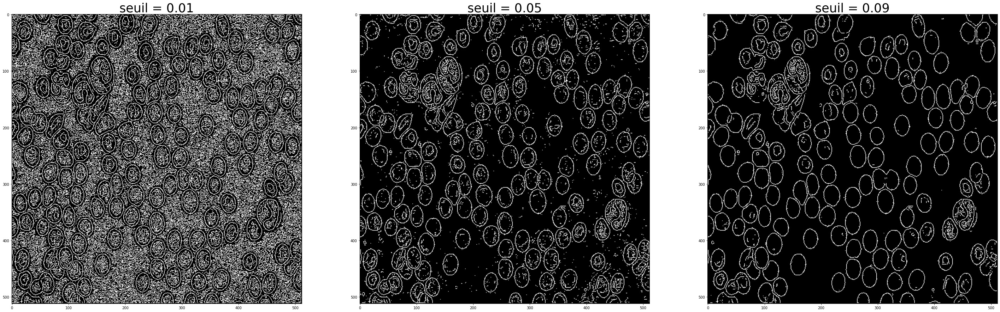

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(valcontours1, cmap="gray")
axs[1].imshow(valcontours2, cmap="gray")
axs[2].imshow(valcontours3, cmap="gray")
axs[0].set_title('seuil = 0.01',fontdict = {'fontsize' :35})
axs[1].set_title('seuil = 0.05',fontdict = {'fontsize' :35})
axs[2].set_title('seuil = 0.09',fontdict = {'fontsize' :35});

fig.savefig('newfig1.png',bbox_inches='tight')

## 1.3


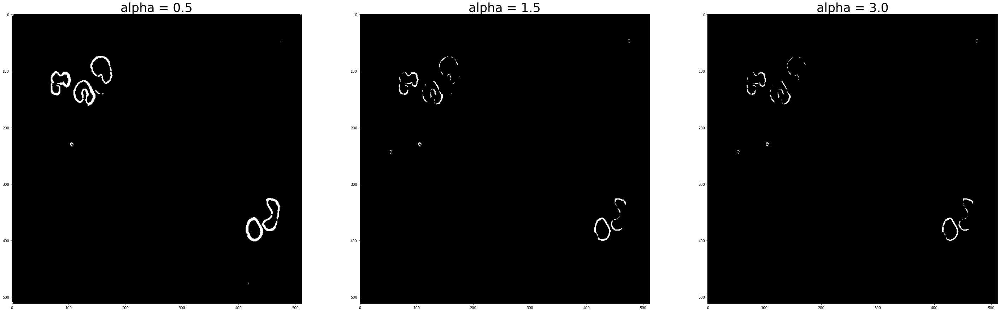

In [ ]:
alpha = [1.0, 3.0, 100.0]
ima = skio.imread('cell.tif')
imgY1 = [mr.dericheGradY(ima,a) for a in alpha]
imgX1 = [mr.dericheGradX(ima,a) for a in alpha]

seuil = 50
norme1 = np.sqrt(imgY1[0]**2+imgX1[0]**2)
norme_seuille1 = (norme1>seuil)

norme2 = np.sqrt(imgY1[1]**2+imgX1[1]**2)
norme_seuille2 = (norme2>seuil)

norme3 = np.sqrt(imgY1[2]**2+imgX1[2]**2)
norme_seuille3 = (norme3>seuil)

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(norme_seuille1.astype("uint8"), cmap="gray")
axs[1].imshow(norme_seuille2.astype("uint8"), cmap="gray")
axs[2].imshow(norme_seuille3.astype("uint8"), cmap="gray")
axs[0].set_title('alpha = 0.5',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 3.0',fontdict = {'fontsize' :35});

fig.savefig('new1.png', bbox_inches='tight')

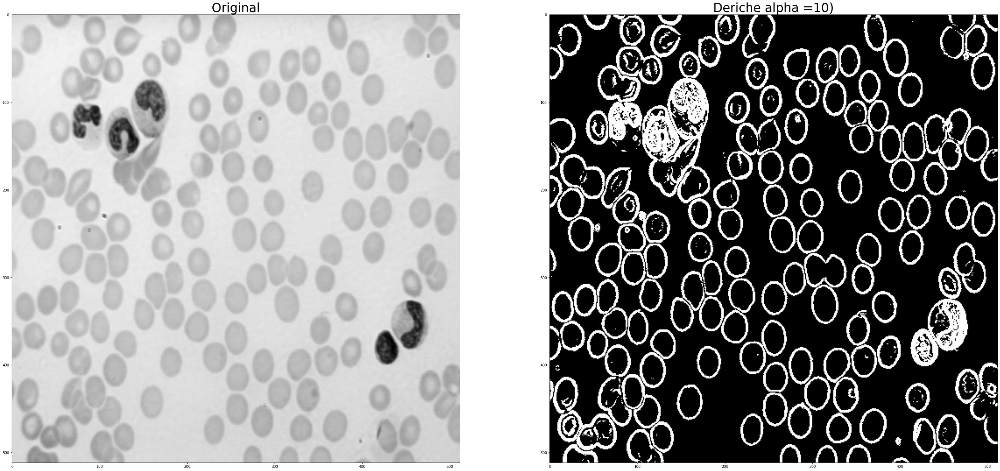

In [ ]:
alpha = 10
ima = skio.imread('cell.tif')
imgY1 = mr.dericheGradY(ima,alpha)
imgX1 = mr.dericheGradX(ima,alpha)

seuil = 8
norme1 = np.sqrt(imgY1**2+imgX1**2)
norme_seuille1 = (norme1>seuil)

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(norme_seuille1.astype("uint8"), cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' :35})
axs[1].set_title('Deriche alpha ='+str(alpha)+')',fontdict = {'fontsize' :35})

fig.savefig('deriche.png', bbox_inches='tight')

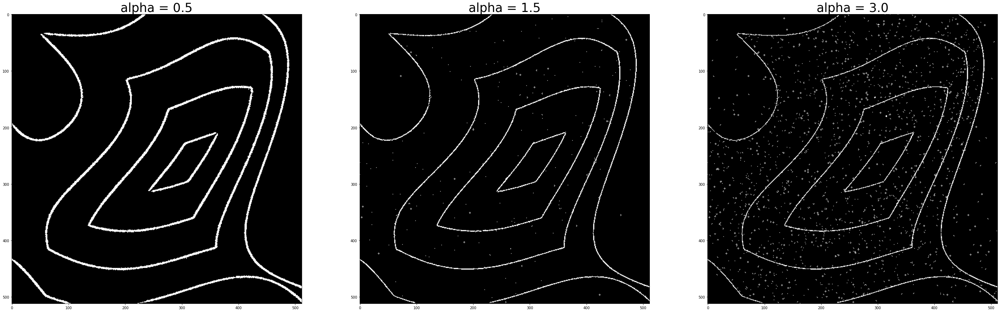

In [ ]:
alpha = [0.5, 1.5, 30.0]
ima = skio.imread('pyrabruit.tif')
imgY1 = [mr.dericheGradY(ima,a) for a in alpha]
imgX1 = [mr.dericheGradX(ima,a) for a in alpha]

seuil = 50
norme1 = np.sqrt(imgY1[0]**2+imgX1[0]**2)
norme_seuille1 = (norme1>seuil)

norme2 = np.sqrt(imgY1[1]**2+imgX1[1]**2)
norme_seuille2 = (norme2>seuil)

norme3 = np.sqrt(imgY1[2]**2+imgX1[2]**2)
norme_seuille3 = (norme3>seuil)

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(norme_seuille1.astype("uint8"), cmap="gray")
axs[1].imshow(norme_seuille2.astype("uint8"), cmap="gray")
axs[2].imshow(norme_seuille3.astype("uint8"), cmap="gray")
axs[0].set_title('alpha = 0.5',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 3.0',fontdict = {'fontsize' :35});

fig.savefig('new1.png', bbox_inches='tight')

(1200, 1920, 3)


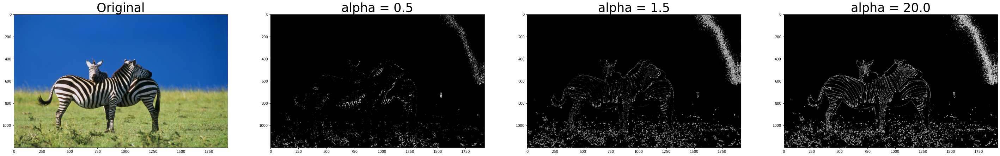

In [ ]:
alpha = [0.5, 1.5, 50.0]
ima = skio.imread('zebres.tif')
print(ima.shape)
imgY1 = [mr.dericheGradY((ima[:,:,0]+ ima[:,:,1]+ ima[:,:,2])/3,a) for a in alpha]
imgX1 = [mr.dericheGradX((ima[:,:,0]+ ima[:,:,1]+ ima[:,:,2])/3,a) for a in alpha]

seuil = 50
norme1 = np.sqrt(imgY1[0]**2+imgX1[0]**2)
norme_seuille1 = (norme1>seuil)

norme2 = np.sqrt(imgY1[1]**2+imgX1[1]**2)
norme_seuille2 = (norme2>seuil)

norme3 = np.sqrt(imgY1[2]**2+imgX1[2]**2)
norme_seuille3 = (norme3>seuil)

fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(norme_seuille1.astype("uint8"), cmap="gray")
axs[2].imshow(norme_seuille2.astype("uint8"), cmap="gray")
axs[3].imshow(norme_seuille3.astype("uint8"), cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 0.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[3].set_title('alpha = 20.0',fontdict = {'fontsize' :35});

fig.savefig('new2.png', bbox_inches='tight')

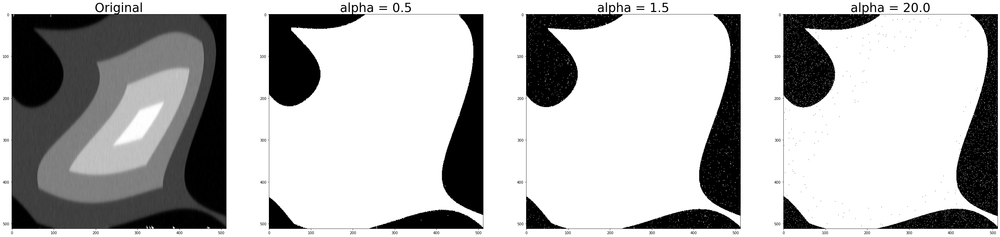

In [ ]:
alpha = [0.5, 1.5, 30.0]
ima = skio.imread('pyrabruit.tif')

imgY1 = [mr.dericheSmoothY(ima,a) for a in alpha]
imgX1 = [mr.dericheSmoothY(ima,a) for a in alpha]

seuil = 20
norme1 = np.sqrt(imgY1[0]**2+imgX1[0]**2)
norme_seuille1 = (norme1>seuil)

norme2 = np.sqrt(imgY1[1]**2+imgX1[1]**2)
norme_seuille2 = (norme2>seuil)

norme3 = np.sqrt(imgY1[2]**2+imgX1[2]**2)
norme_seuille3 = (norme3>seuil)

fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(50, 50))
axs[0].imshow(imgY1[0].astype("uint8"), cmap="gray")
axs[1].imshow(norme_seuille1.astype("uint8"), cmap="gray")
axs[2].imshow(norme_seuille2.astype("uint8"), cmap="gray")
axs[3].imshow(norme_seuille3.astype("uint8"), cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 0.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[3].set_title('alpha = 20.0',fontdict = {'fontsize' :35});

fig.savefig('new2.png', bbox_inches='tight')

## 1.4


In [ ]:
ima = plt.imread('pyramide.tif')

alpha=[0.1, 1.5, 20]

#derivada primeira
gradx=np.array([mr.dericheGradX(mr.dericheSmoothY(ima,a),a) for a in alpha])
grady=np.array([mr.dericheGradY(mr.dericheSmoothX(ima,a),a) for a in alpha])

grad, gradx2,grady2,lpima,posneg=[np.copy(gradx) for i in range(5)]#,np.copy(gradx),np.copy(gradx)

for i, a in enumerate(alpha):
  grad[i] = np.sqrt(gradx[i]**2+grady[i]**2)
  #derivada segunda
  gradx2[i]=mr.dericheGradX(mr.dericheSmoothY(gradx[i,:,:],a),a)
  grady2[i]=mr.dericheGradY(mr.dericheSmoothX(grady[i,:,:],a),a)
  lpima[i]= gradx2[i]+grady2[i]
  #binarizando
  posneg[i]=(lpima[i]>=0)

n,nl,nc=posneg.shape
contours=np.uint8(np.zeros((n,nl,nc)))

for k in range(n):
  for i in range(1,nl):
      for j in range(1,nc):
          if (((i>0) and (posneg[k,i-1,j] != posneg[k,i,j])) or
              ((j>0) and (posneg[k,i,j-1] != posneg[k,i,j]))):
              contours[k,i,j]=255

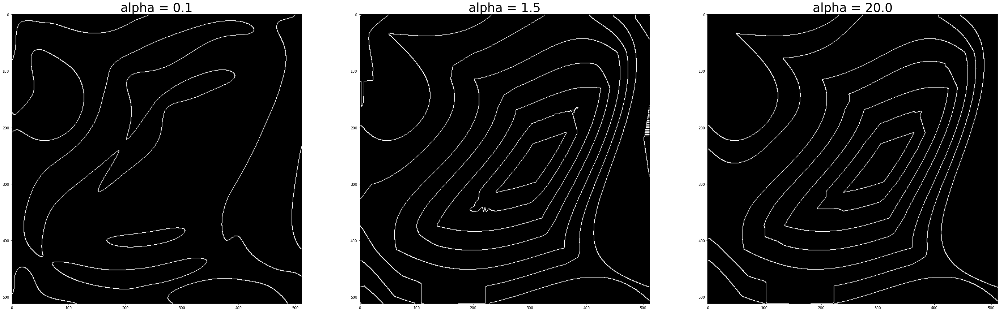

In [ ]:

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(contours[0,:].astype("uint8"), cmap="gray")
axs[1].imshow(contours[1,:].astype("uint8"), cmap="gray")
axs[2].imshow(contours[2,:].astype("uint8"), cmap="gray")
axs[0].set_title('alpha = 0.1',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 20.0',fontdict = {'fontsize' :35});

fig.savefig('new4.png', bbox_inches='tight')

In [ ]:
ima = plt.imread('cell.tif')

alpha=[0.5, 1.5, 20]

#derivada primeira
gradx=np.array([mr.dericheGradX(mr.dericheSmoothY(ima,a),a) for a in alpha])
grady=np.array([mr.dericheGradY(mr.dericheSmoothX(ima,a),a) for a in alpha])

grad, gradx2,grady2,lpima,posneg=[np.copy(gradx) for i in range(5)]#,np.copy(gradx),np.copy(gradx)

for i, a in enumerate(alpha):
  grad[i] = np.sqrt(gradx[i]**2+grady[i]**2)
  #derivada segunda
  gradx2[i]=mr.dericheGradX(mr.dericheSmoothY(gradx[i,:,:],a),a)
  grady2[i]=mr.dericheGradY(mr.dericheSmoothX(grady[i,:,:],a),a)
  lpima[i]= gradx2[i]+grady2[i]
  #binarizando
  posneg[i]=(lpima[i]>=0)

n,nl,nc=posneg.shape
contours=np.uint8(np.zeros((n,nl,nc)))

for k in range(n):
  for i in range(1,nl):
      for j in range(1,nc):
          if (((i>0) and (posneg[k,i-1,j] != posneg[k,i,j])) or
              ((j>0) and (posneg[k,i,j-1] != posneg[k,i,j]))):
              contours[k,i,j]=255

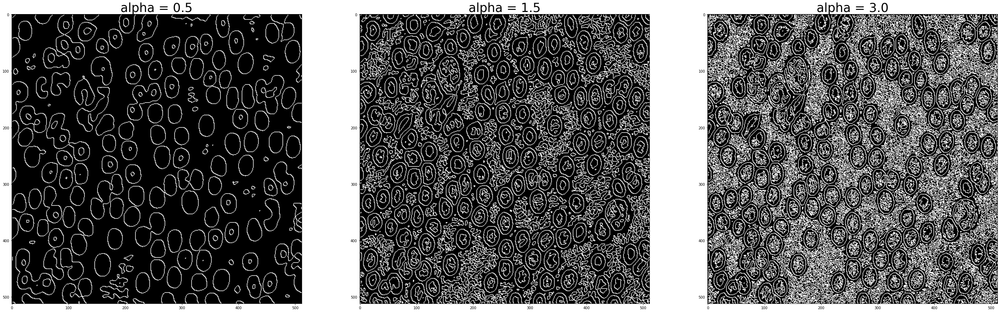

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(contours[0,:].astype("uint8"), cmap="gray")
axs[1].imshow(contours[1,:].astype("uint8"), cmap="gray")
axs[2].imshow(contours[2,:].astype("uint8"), cmap="gray")
axs[0].set_title('alpha = 0.5',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 3.0',fontdict = {'fontsize' :35});

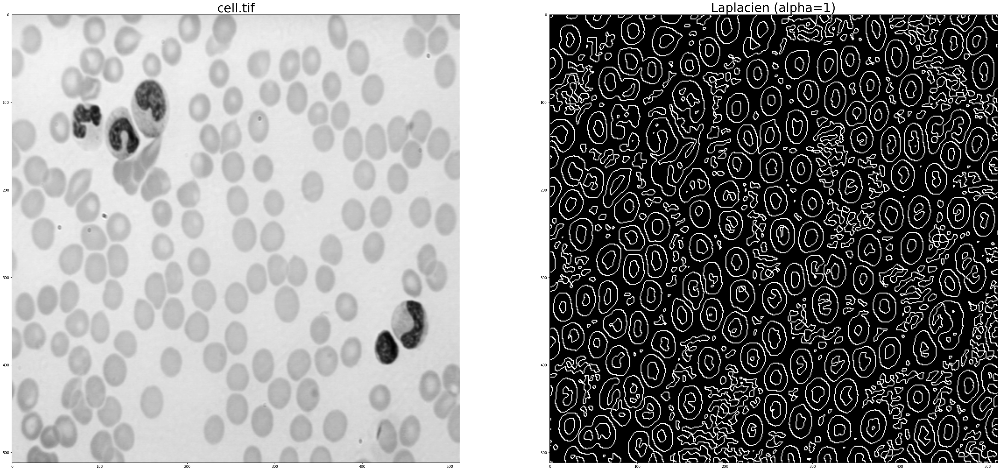

In [ ]:
ima = plt.imread('cell.tif')

alpha=1

#derivada primeira
gradx=np.array(mr.dericheGradX(mr.dericheSmoothY(ima,alpha),alpha))
grady=np.array(mr.dericheGradY(mr.dericheSmoothX(ima,alpha),alpha))

grad, gradx2,grady2,lpima,posneg=[np.copy(gradx) for i in range(5)]#,np.copy(gradx),np.copy(gradx)

grad = np.sqrt(gradx**2+grady**2)
#derivada segunda
gradx2=mr.dericheGradX(mr.dericheSmoothY(gradx,alpha),alpha)
grady2=mr.dericheGradY(mr.dericheSmoothX(grady,alpha),alpha)
lpima= gradx2+grady2
#binarizando
posneg=(lpima>=0)

nl,nc=posneg.shape
contours=np.uint8(np.zeros((nl,nc)))


for i in range(1,nl):
    for j in range(1,nc):
        if (((i>0) and (posneg[i-1,j] != posneg[i,j])) or
            ((j>0) and (posneg[i,j-1] != posneg[i,j]))):
            contours[i,j]=255

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(contours.astype("uint8"), cmap="gray")
axs[0].set_title('cell.tif',fontdict = {'fontsize' :35})
axs[1].set_title('Laplacien (alpha='+str(alpha)+')',fontdict = {'fontsize' :35})

fig.savefig('laplacien.png', bbox_inches='tight')


In [ ]:
ima = plt.imread('pyramide.tif')

alpha=[0.05, 1.5, 20]

#derivada primeira
gradx=np.array([mr.dericheGradX(mr.dericheSmoothY(ima,a),a) for a in alpha])
grady=np.array([mr.dericheGradY(mr.dericheSmoothX(ima,a),a) for a in alpha])

grad, gradx2,grady2,lpima,posneg=[np.copy(gradx) for i in range(5)]#,np.copy(gradx),np.copy(gradx)

for i, a in enumerate(alpha):
  grad[i] = np.sqrt(gradx[i]**2+grady[i]**2)
  #derivada segunda
  gradx2[i]=mr.dericheGradX(mr.dericheSmoothY(gradx[i,:,:],a),a)
  grady2[i]=mr.dericheGradY(mr.dericheSmoothX(grady[i,:,:],a),a)
  lpima[i]= gradx2[i]+grady2[i]
  #binarizando
  posneg[i]=(lpima[i]>=0)

n,nl,nc=posneg.shape
contours=np.uint8(np.zeros((n,nl,nc)))

for k in range(n):
  for i in range(1,nl):
      for j in range(1,nc):
          if ((((i>0) and (posneg[k,i-1,j] != posneg[k,i,j])) or
              ((j>0) and (posneg[k,i,j-1] != posneg[k,i,j]))) and grad[k,i,j]>=1.5):
              contours[k,i,j]=255

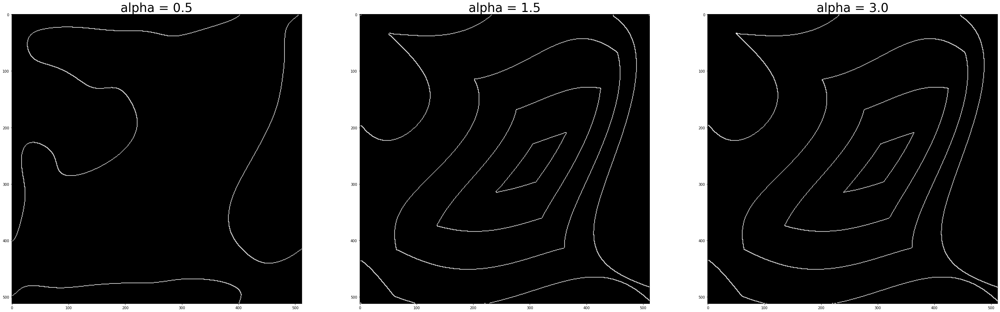

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(contours[0,:].astype("uint8"), cmap="gray")
axs[1].imshow(contours[1,:].astype("uint8"), cmap="gray")
axs[2].imshow(contours[2,:].astype("uint8"), cmap="gray")
axs[0].set_title('alpha = 0.5',fontdict = {'fontsize' :35})
axs[1].set_title('alpha = 1.5',fontdict = {'fontsize' :35})
axs[2].set_title('alpha = 3.0',fontdict = {'fontsize' :35});

## 1.5


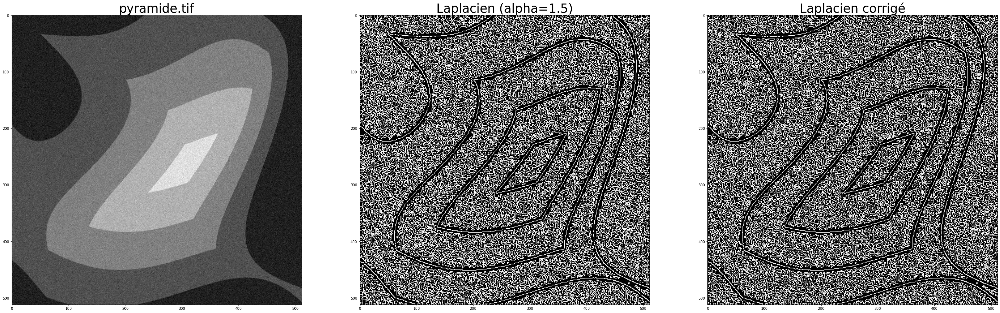

In [ ]:
ima = plt.imread('pyra-gauss.tif')

alpha=1.5

#derivada primeira
gradx=np.array(mr.dericheGradX(mr.dericheSmoothY(ima,alpha),alpha))
grady=np.array(mr.dericheGradY(mr.dericheSmoothX(ima,alpha),alpha))

grad,gradx2,grady2,lpima,posneg=[np.copy(gradx) for i in range(5)]#,np.copy(gradx),np.copy(gradx)

grad = np.sqrt(gradx**2+grady**2)
#derivada segunda
gradx2=mr.dericheGradX(mr.dericheSmoothY(gradx,alpha),alpha)
grady2=mr.dericheGradY(mr.dericheSmoothX(grady,alpha),alpha)
lpima= gradx2+grady2
#binarizando
posneg=(lpima>=0)

nl,nc=posneg.shape
contours=np.uint8(np.zeros((nl,nc)))
contours_corrige=np.uint8(np.zeros((nl,nc)))

for i in range(1,nl):
    for j in range(1,nc):
        if (((i>0) and (posneg[i-1,j] != posneg[i,j])) or
            ((j>0) and (posneg[i,j-1] != posneg[i,j]))):
            contours[i,j]=255
        if ((((i>0) and (posneg[i-1,j] != posneg[i,j])) or
            ((j>0) and (posneg[i,j-1] != posneg[i,j]))) and grad[i,j]>=1.5):
            contours_corrige[i,j]=255

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(contours.astype("uint8"), cmap="gray")
axs[2].imshow(contours_corrige.astype("uint8"), cmap="gray")
axs[0].set_title('pyramide.tif',fontdict = {'fontsize' :35})
axs[1].set_title('Laplacien (alpha='+str(alpha)+')',fontdict = {'fontsize' :35})
axs[2].set_title('Laplacien corrigé',fontdict = {'fontsize' :35})


fig.savefig('laplacien.png', bbox_inches='tight')


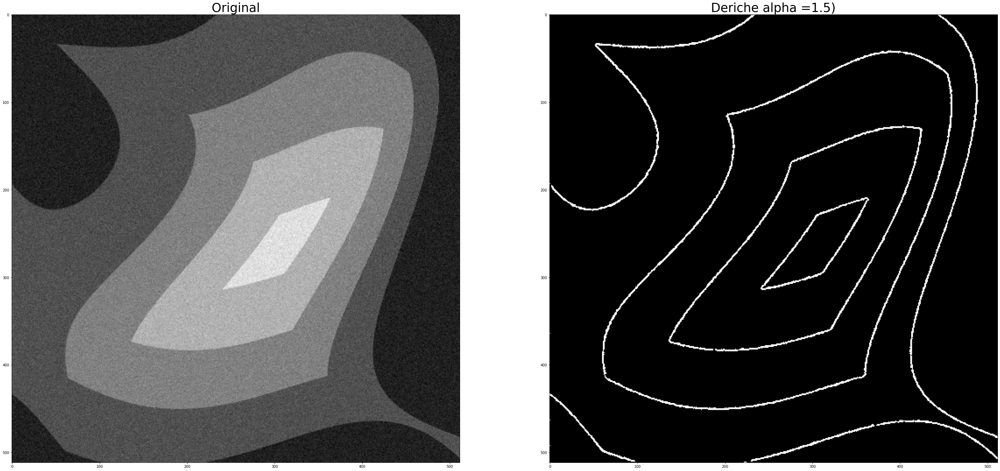

In [ ]:
alpha = 10
ima = skio.imread('pyra-gauss.tif')
imgY1 = mr.dericheGradY(median_filter(ima,typ=1,r=1,xy=None),alpha)
imgX1 = mr.dericheGradX(median_filter(ima,typ=1,r=1,xy=None),alpha)

seuil = 20
norme1 = np.sqrt(imgY1**2+imgX1**2)
norme_seuille1 = (norme1>seuil)

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(norme_seuille1.astype("uint8"), cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' :35})
axs[1].set_title('Deriche alpha ='+str(alpha)+')',fontdict = {'fontsize' :35})

fig.savefig('deriche.png', bbox_inches='tight')

## 2)

In [ ]:
def tophat(im,rayon):
    se=morpho.square(rayon)
    ero=morpho.erosion(im,se)
    dil=morpho.dilation(ero,se)
    tophat=im-dil
    return tophat

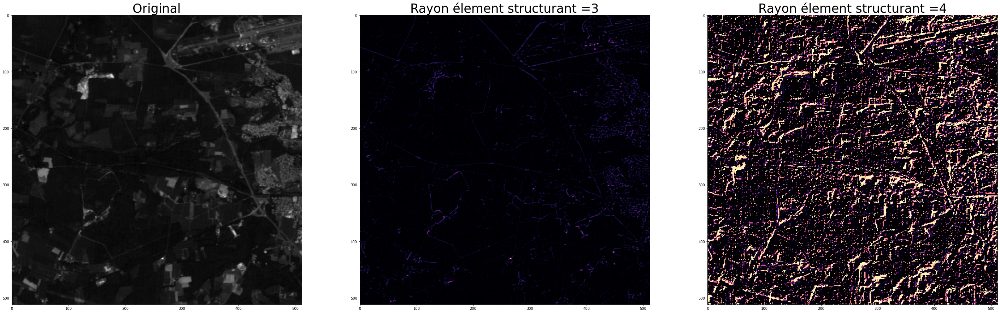

In [ ]:
ima = skio.imread('spot.tif')
rayures = [3, 4]
im = [tophat(ima, r) for r in rayures]

fig, axs = plt.subplots(nrows=1, ncols=len(rayures)+1, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(im[0].astype("uint8"), cmap="magma")
axs[2].imshow(im[1].astype("uint8"), cmap="magma")
axs[0].set_title('Original',fontdict = {'fontsize' :35})
axs[1].set_title('Rayon élement structurant ='+str(rayures[0]),fontdict = {'fontsize' :35})
axs[2].set_title('Rayon élement structurant ='+str(rayures[1]),fontdict = {'fontsize' :35})

fig.savefig('spot3.png', bbox_inches='tight')

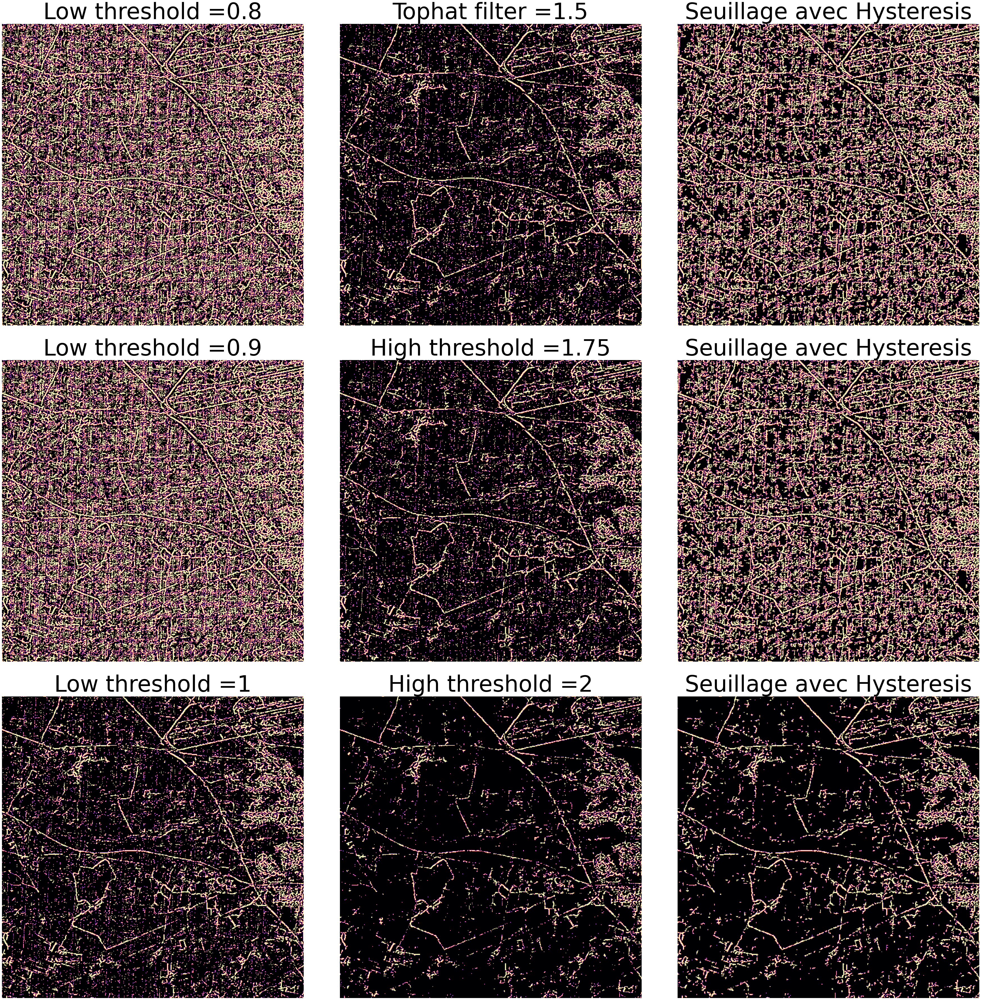

In [ ]:
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(50, 50))

ima = skio.imread('spot.tif');
rayon=3
top=tophat(ima,rayon)

low = 0.8
high = 1.5

lowt = (top > low).astype(int)
hight = (top > high).astype(int)
hyst = filters.apply_hysteresis_threshold(top, low, high)

low1 = 0.9
high1 = 1.75

lowt1 = (top > low1).astype(int)
hight1 = (top > high1).astype(int)
hyst1 = filters.apply_hysteresis_threshold(top, low1, high1)

low2 = 1
high2 = 2

lowt2 = (top > low2).astype(int)
hight2 = (top > high2).astype(int)
hyst2 = filters.apply_hysteresis_threshold(top, low2, high2)


ax[0, 0].imshow(lowt, cmap='magma')
ax[0, 0].set_title('Low threshold ='+str(low),fontdict = {'fontsize' :80})

ax[0, 1].imshow(hight, cmap='magma')
ax[0, 1].set_title('Tophat filter ='+str(high),fontdict = {'fontsize' :80})

ax[0, 2].imshow(hyst, cmap='magma')
ax[0, 2].set_title('Seuillage avec Hysteresis',fontdict = {'fontsize' :80})

ax[1, 0].imshow(lowt1, cmap='magma')
ax[1, 0].set_title('Low threshold ='+str(low1),fontdict = {'fontsize' :80})

ax[1, 1].imshow(hight1, cmap='magma')
ax[1, 1].set_title('High threshold ='+str(high1),fontdict = {'fontsize' :80})

ax[1, 2].imshow(hyst1, cmap='magma')
ax[1, 2].set_title('Seuillage avec Hysteresis',fontdict = {'fontsize' :80})

ax[2, 0].imshow(lowt2, cmap='magma')
ax[2, 0].set_title('Low threshold ='+str(low2),fontdict = {'fontsize' :80})

ax[2, 1].imshow(hight2, cmap='magma')
ax[2, 1].set_title('High threshold ='+str(high2),fontdict = {'fontsize' :80})

ax[2, 2].imshow(hyst2, cmap='magma')
ax[2, 2].set_title('Seuillage avec Hysteresis',fontdict = {'fontsize' :80})

# ax[0, 2].imshow(hyst, cmap='magma')
# ax[0, 2].set_title('Hysteresis')

# ax[1, 2].imshow(hight + hyst, cmap='magma')
# ax[1, 2].set_title('High + Hysteresis')

for a in ax.ravel():
    a.axis('off')

plt.tight_layout()

plt.show()

fig.savefig('hysteresis.png', bbox_inches='tight')

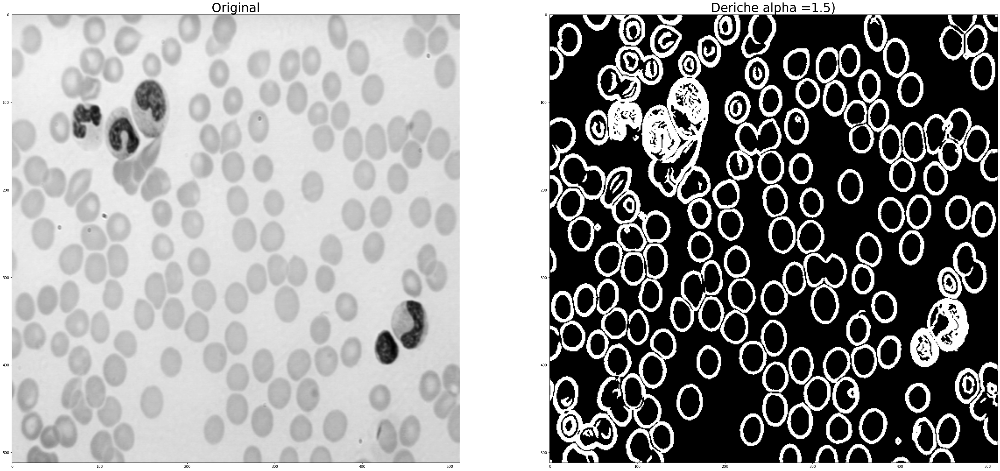

In [ ]:
alpha = 1.5
ima = skio.imread('cell.tif')
imgY1 = mr.dericheGradY(median_filter(ima,typ=1,r=1,xy=None),alpha)
imgX1 = mr.dericheGradX(median_filter(ima,typ=1,r=1,xy=None),alpha)

seuil = 10
norme1 = np.sqrt(imgY1**2+imgX1**2)
# norme_seuille1 = (norme1>seuil)

low = 8
high = 12

lowt = (norme1 > low).astype(int)
hight = (norme1 > high).astype(int)
hyst = filters.apply_hysteresis_threshold(norme1, low, high)

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(50, 50))
axs[0].imshow(ima.astype("uint8"), cmap="gray")
axs[1].imshow(hyst.astype("uint8"), cmap="gray")
axs[0].set_title('Original',fontdict = {'fontsize' :35})
axs[1].set_title('Deriche alpha ='+str(alpha)+')',fontdict = {'fontsize' :35})

fig.savefig('deriche.png', bbox_inches='tight')

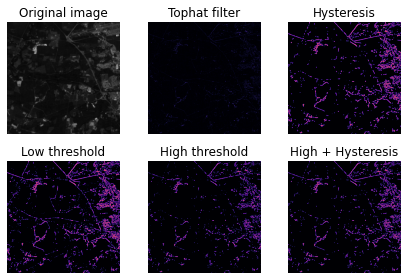

In [ ]:
import hysteresis

Fitting model on a small sub-sample of the data
done in 0.077s.
Predicting color indices on the full image (k-means)
done in 0.013s.


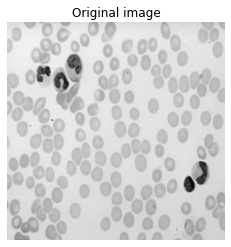

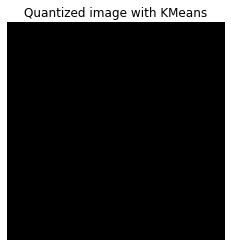

In [ ]:
import kmeans1

Fitting model on a small sub-sample of the data
done in 0.153s.
Predicting color indices on the full image (k-means)
done in 0.096s.


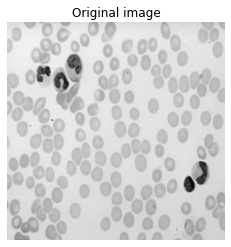

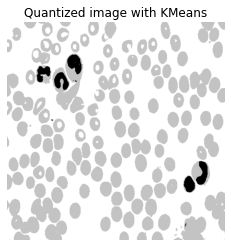

In [ ]:
import kmeans1

Fitting model on a small sub-sample of the data
done in 0.021s.
Predicting color indices on the full image (k-means)
done in 0.071s.


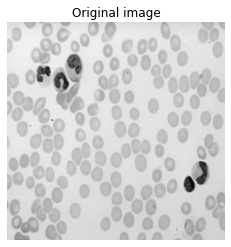

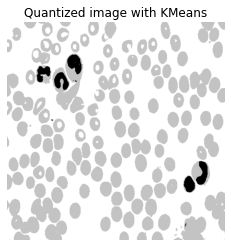

In [ ]:
import kmeans1

In [ ]:
def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)

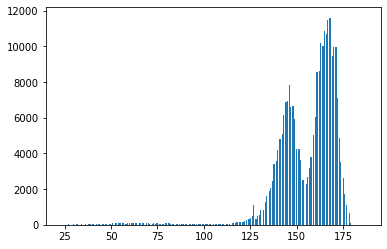

In [ ]:
ima = skio.imread('cell.tif')

histo = histogram(ima)

plt.figure('superposition')
plt.hist(ima.reshape((-1,)),bins=255) # I would add interpolation='none'
plt.show()


Fitting model on a small sub-sample of the data
done in 0.863s.
Predicting color indices on the full image (k-means)
done in 0.020s.


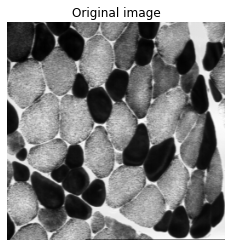

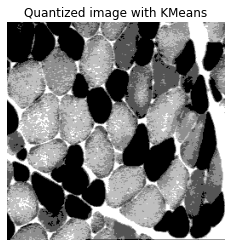

In [ ]:
#!/usr/bin/env python2
# -*- coding: utf-8 -*-

# Authors: Robert Layton <robertlayton@gmail.com>
#          Olivier Grisel <olivier.grisel@ensta.org>
#          Mathieu Blondel <mathieu@mblondel.org>
#

import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin
from sklearn.datasets import load_sample_image
from sklearn.utils import shuffle
from time import time
from skimage.io import imread

n_class = 5

ima=imread('muscle.tif')
# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
ima = np.array(ima, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h = original_shape = tuple(ima.shape)
d = 1
image_array = np.reshape(ima, (w * h, d))

print("Fitting model on a small sub-sample of the data")
t0 = time()
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans = KMeans(n_clusters=n_class, random_state=0).fit(image_array_sample)
print("done in %0.3fs." % (time() - t0))

# Get labels for all points
print("Predicting color indices on the full image (k-means)")
t0 = time()
labels = kmeans.predict(image_array)
print("done in %0.3fs." % (time() - t0))

def recreate_image(codebook, labels, w, h):
    """Recreate the (compressed) image from the code book & labels"""
    image = np.zeros((w, h))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image

# Display all results, alongside original image
plt.figure(1)
plt.clf()
plt.axis('off')
plt.title('Original image')
plt.imshow(ima,cmap='gray')

plt.figure(2)
plt.clf()
plt.axis('off')
plt.title('Quantized image with KMeans')
plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h),cmap='gray')
plt.show()



import kmeans3

Fitting model on a small sub-sample of the data
done in 0.652s.
Predicting color indices on the full image (k-means)
done in 0.148s.


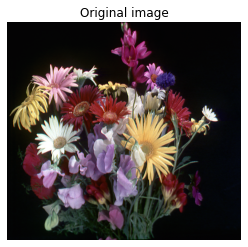

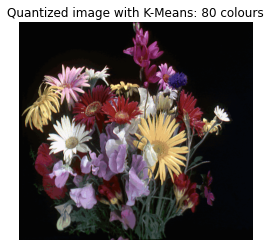

In [ ]:
import kmeans3

152
153


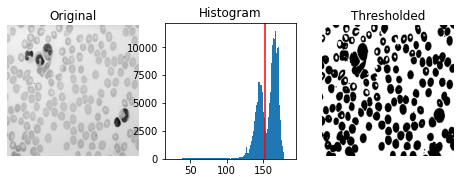

In [ ]:
import otsu

152
153


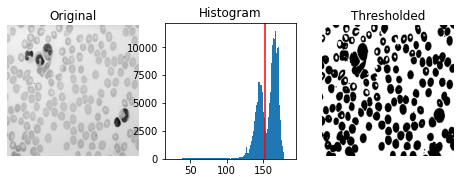

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


image = skio.imread('cell.tif')
thresh = threshold_otsu(image)
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




79
84


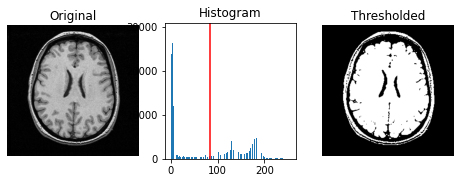

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


image = skio.imread('cerveau.tif')
thresh = threshold_otsu(median_filter(image,typ=1,r=15,xy=None))
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




116
117


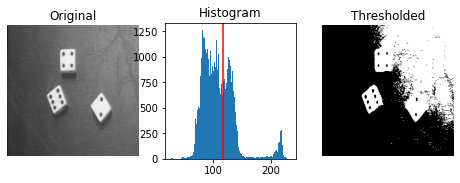

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


image = skio.imread('dice1.tif')
thresh = threshold_otsu(image)
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




112
113


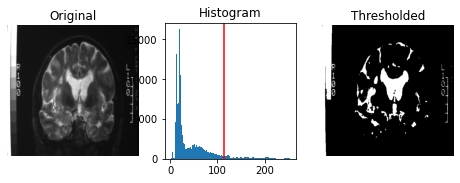

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


image = skio.imread('brain.tif')
thresh = threshold_otsu(image)
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




104
105


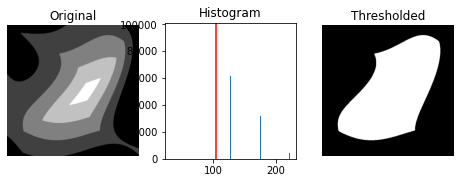

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


image = skio.imread('pyramide.tif')
thresh = threshold_otsu(image)
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




In [ ]:
alpha = 1.5
ima = skio.imread('cell.tif')
imgY1 = mr.dericheGradY(median_filter(ima,typ=1,r=1,xy=None),alpha)
imgX1 = mr.dericheGradX(median_filter(ima,typ=1,r=1,xy=None),alpha)

seuil = 10
norme1 = np.sqrt(imgY1**2+imgX1**2)
# norme_seuille1 = (norme1>seuil)

10
11


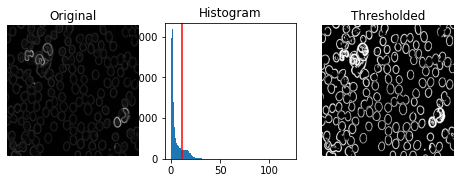

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


#
image = norme1.astype(int)
thresh = threshold_otsu(image)
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




In [ ]:
ima=io.imread('cell.tif')
sigma=5
# seuilnorme=30
# seuilnorme=0.1

gfima=filters.gaussian(ima,sigma)
#gfima=ima.copy()
gradx=mr.sobelGradX(gfima)

grady=mr.sobelGradY(gfima)
norme=np.sqrt(gradx*gradx+grady*grady)
direction=np.arctan2(grady,gradx)

0
0


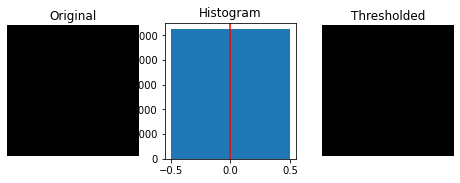

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Sep 30 15:22:20 2020

@author: mroux
"""


import matplotlib.pyplot as plt
from skimage import data
from skimage import io as skio
from skimage.filters import threshold_otsu
import numpy as np

def histogram(im):

    nl,nc=im.shape

    hist=np.zeros(256)

    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1

    for i in range(256):
        hist[i]=hist[i]/(nc*nl)

    return(hist)


def otsu_thresh(im):

    h=histogram(im)

    m=0
    for i in range(256):
        m=m+i*h[i]

    maxt=0
    maxk=0


    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0

        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:
            m1=m1/w1

        k=w0*w1*(m0-m1)*(m0-m1)

        if k > maxk:
            maxk=k
            maxt=t


    thresh=maxt

    return(thresh)


#
image = norme.astype(int)
thresh = threshold_otsu(image)
print(thresh)
binary = image > thresh

thresh=otsu_thresh(image)
binary = image > thresh
print(thresh)

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(image, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

bins=np.max(image)-np.min(image)+1

ax[1].hist(image.ravel(), bins=bins)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()




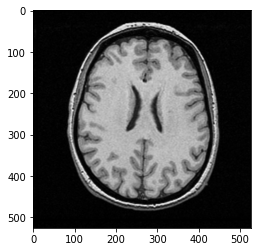

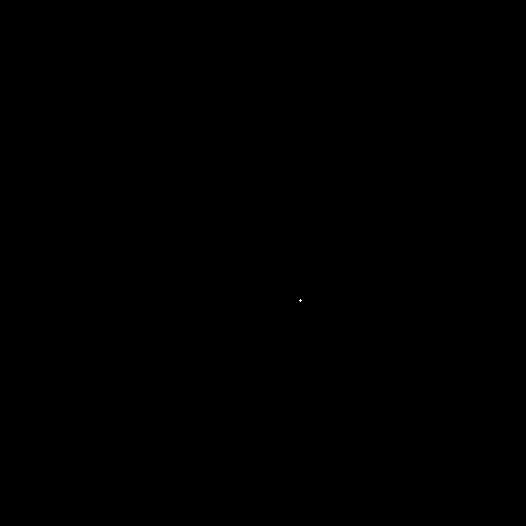

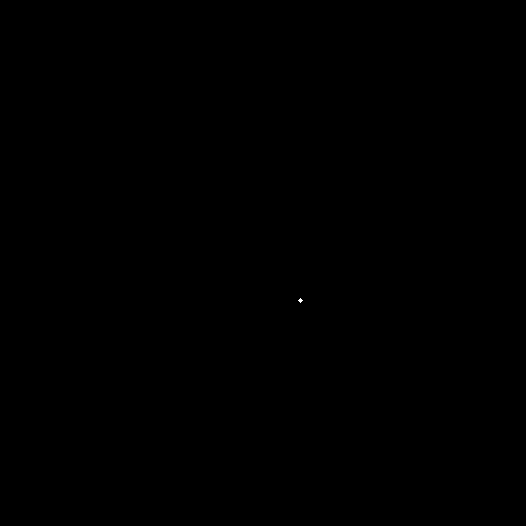

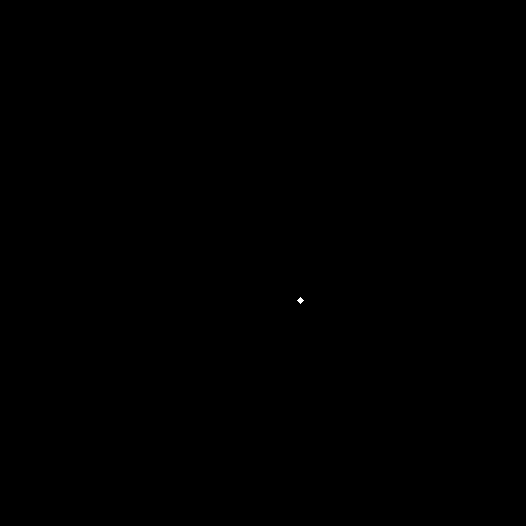

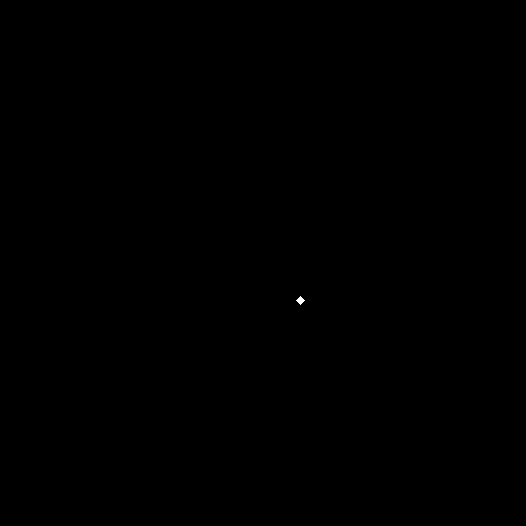

...

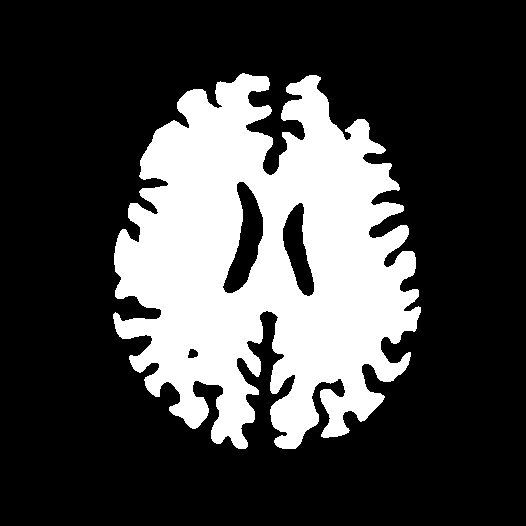

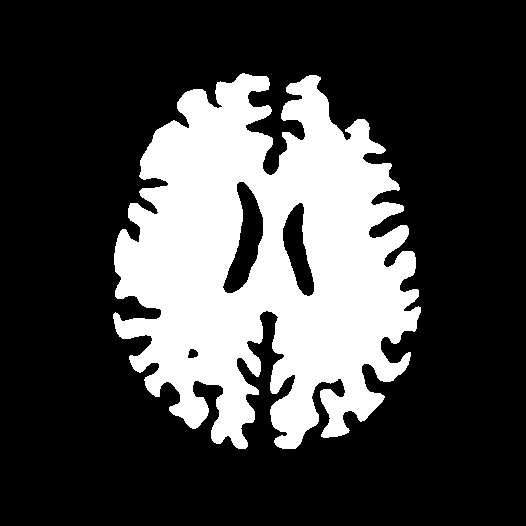

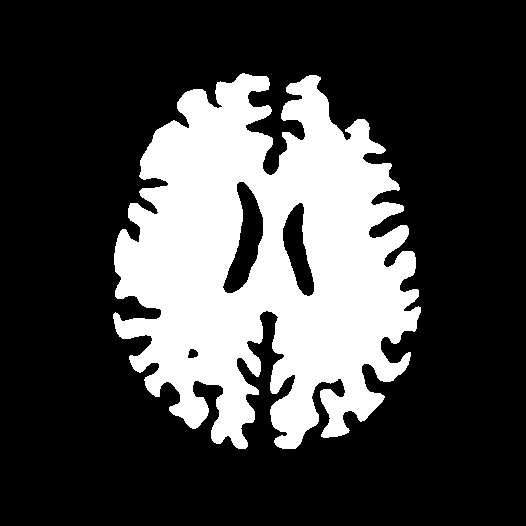

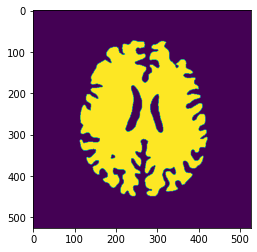

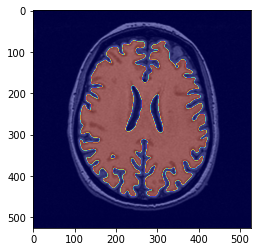

In [ ]:
import region_growing

Fitting model on a small sub-sample of the data
done in 0.221s.
Predicting color indices on the full image (k-means)
done in 0.110s.


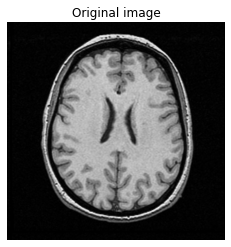

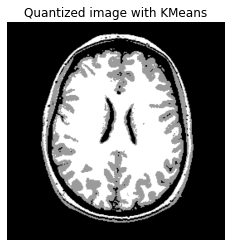

In [ ]:
import kmeans1

Fitting model on a small sub-sample of the data
done in 0.025s.
Predicting color indices on the full image (k-means)
done in 0.046s.


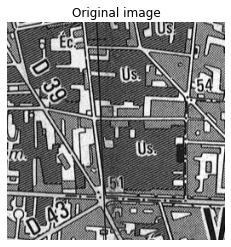

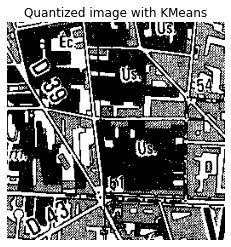

In [ ]:
import kmeans1